In [1]:
import time
import pandas as pd
import numpy as np
from tqdm import tqdm
import plotly as px
import plotly.graph_objects as go
import matplotlib.pyplot as plt
import os
import warnings

warnings.filterwarnings('ignore', category=UserWarning)
warnings.filterwarnings('ignore', category=FutureWarning)

# Importacion y preprocesamiento de datos

In [2]:
direccion=r"C:/Users/Guille/Desktop/Clustering_Guille/dataset_csv/Metropolitano142.csv"
df = pd.DataFrame()
df = pd.read_csv(direccion)

df["Hora"]=pd.to_datetime(df["Hora"],  format='%Y-%m-%d %H:%M:%S',dayfirst=True)
df.rename(columns={"Hora": "Fecha"}, inplace=True)
df['Hora'] = df['Fecha'].dt.hour

# cortamos el rango que no nos sirve
df=df[df["Fecha"]>'2022-01-07 23:00:00']
extra_rows = len(df) % 24
if extra_rows != 0:
    df = df.iloc[:-extra_rows]

# hallamos los valores vacios y los llenamos con el valor promedio de su columna
nan_columns = df.columns[df.isnull().any()].tolist()
df[nan_columns] = df[nan_columns].fillna(df[nan_columns].mean())

data=df.copy()
data["Fecha"]=pd.to_datetime(data["Fecha"],dayfirst=True)
data = data.set_index('Fecha')
data.pop(data.columns.values[-1])

data # 121 usuarios, 552 horas = 23 días

,171,170,169,168,167,166,165,164,163,162,...,60,59,58,57,56,55,54,53,52,51
Fecha,,,,,,,,,,,,,,,,,,,,,
2022-01-08 00:00:00,2.656,1.936,3.420,0.332,2.402,3.626000,2.994,1.340,2.222000,4.986,...,0.924,1.568,1.882,3.208,0.112,1.920,1.596,2.594,0.922,2.852
2022-01-08 01:00:00,2.204,1.504,3.680,0.324,2.998,3.024000,4.178,1.262,2.044000,3.656,...,0.242,1.460,1.942,2.864,0.112,1.418,1.722,2.018,2.572,2.748
2022-01-08 02:00:00,2.188,1.452,2.676,0.674,2.772,2.758000,3.858,0.956,1.766000,3.268,...,0.624,0.202,1.922,2.602,0.108,1.024,1.548,1.992,2.798,2.572
2022-01-08 03:00:00,1.924,1.398,2.508,0.366,5.884,1.028000,3.418,0.194,3.506000,3.308,...,0.352,0.158,1.850,2.260,0.108,0.988,2.754,1.922,2.418,2.556
2022-01-08 04:00:00,1.796,1.412,2.280,0.320,6.868,0.520000,3.352,0.230,3.122000,4.306,...,0.234,0.086,1.832,1.922,0.106,0.474,2.776,1.898,1.626,1.924
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2022-01-30 19:00:00,1.306,1.208,3.300,2.590,0.662,1.797503,0.872,2.014,3.081973,1.572,...,0.070,0.030,2.640,0.746,0.300,2.172,2.618,0.960,0.244,2.678
2022-01-30 20:00:00,0.748,0.796,3.478,3.944,0.712,1.797503,0.724,1.980,3.081973,2.266,...,0.068,0.174,2.404,1.236,0.296,1.812,2.460,1.206,0.200,2.836
2022-01-30 21:00:00,1.760,0.584,3.176,3.120,0.704,1.797503,0.852,1.462,3.081973,3.260,...,0.062,0.794,2.070,0.984,0.288,2.722,2.170,2.958,0.818,2.358


# Periodograma de Lomb-Scargle

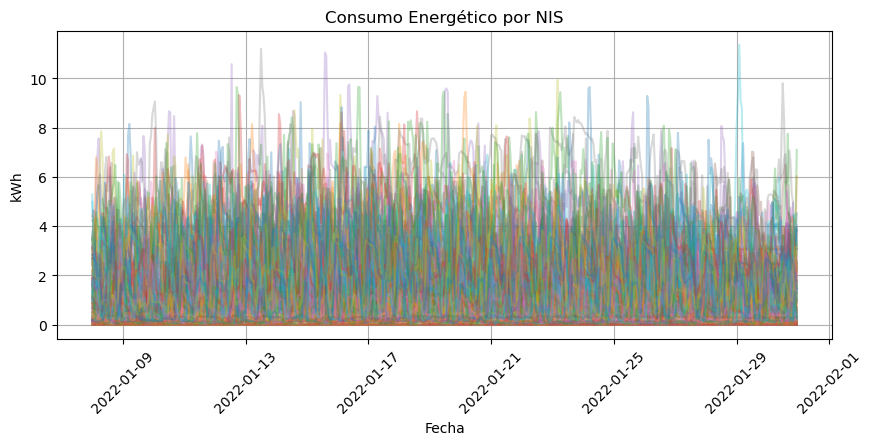

In [3]:
import matplotlib.pyplot as plt

# Graficamos cada usuario como una línea en el tiempo
plt.figure(figsize=(10, 4))
for column in data.columns:
    plt.plot(data.index, data[column], alpha=0.3)  # Alpha para transparencia

plt.xlabel("Fecha")
plt.ylabel("kWh")
plt.title("Consumo Energético por NIS")
plt.xticks(rotation=45)
plt.grid(True)
plt.show()


c:\Users\Guille\anaconda3\Lib\site-packages\astropy\timeseries\periodograms\lombscargle\implementations\fast_impl.py:134: RuntimeWarning: invalid value encountered in divide
  power /= YY


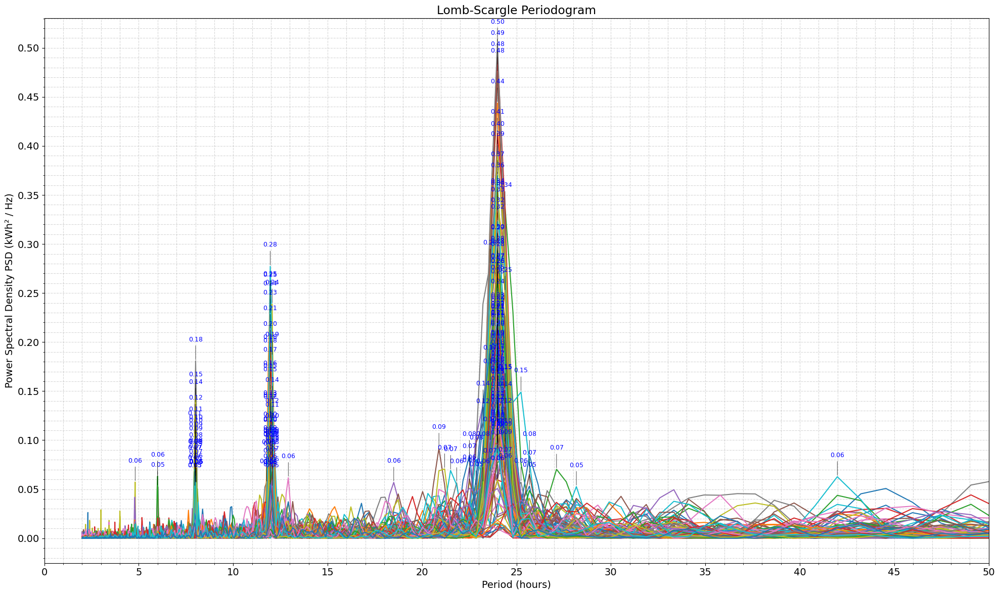

Cantidad de usuarios con PSD > 0.05: 111
Usuarios con PSD alto: ['171', '170', '169', '168', '167', '166', '165', '164', '163', '162', '161', '159', '158', '157', '156', '155', '154', '153', '152', '151', '150', '149', '148', '147', '146', '145', '144', '143', '142', '141', '140', '139', '138', '137', '136', '135', '134', '133', '132', '131', '130', '129', '127', '126', '125', '124', '123', '119', '115', '114', '113', '112', '111', '110', '109', '108', '107', '106', '105', '104', '103', '102', '101', '100', '99', '98', '97', '96', '95', '94', '93', '92', '91', '90', '89', '88', '87', '86', '85', '83', '82', '81', '80', '79', '77', '76', '75', '74', '73', '72', '71', '70', '69', '68', '67', '66', '65', '64', '63', '62', '61', '60', '59', '58', '57', '56', '55', '54', '53', '52', '51']
Usuarios con PSD bajo: ['160', '128', '122', '121', '120', '118', '117', '116', '84', '78']


In [ ]:
from astropy.timeseries import LombScargle
from scipy.signal import find_peaks
from matplotlib.ticker import MultipleLocator, AutoMinorLocator

num_usuarios_a_mostrar = 121
usuarios_seleccionados = data.columns[:num_usuarios_a_mostrar]

# Convertimos el índice (fechas) a valores numéricos en horas
time = (data.index - data.index[0]).total_seconds() / 3600

plt.figure(figsize=(20, 12))
plt.rcParams.update({'font.size': 14})

frequencies = np.linspace(1/(1*168), 1/2, 720)  # Frecuencias en Hz
delta_f = frequencies[1] - frequencies[0]       # Resolución de frecuencia

usuarios_psd_alto = []
usuarios_psd_bajo = []

for usuario in usuarios_seleccionados:
    consumo_usuario = data[usuario].dropna()
    tiempo_usuario = time[data[usuario].notna()]
    
    ls = LombScargle(tiempo_usuario, consumo_usuario)
    power_spectrum = ls.power(frequencies)
    periods = frequencies**-1

    max_psd = np.max(power_spectrum)

    if max_psd > 0.05:
        usuarios_psd_alto.append(usuario)
        # Graficar periodograma
        plt.plot(periods, power_spectrum, label=f'{usuario}')
        # Picos significativos
        peaks, _ = find_peaks(power_spectrum, height=0.051)
        for peak in peaks:
            period = periods[peak]
            psd = power_spectrum[peak]
            plt.annotate(f'{psd:.2f}', xy=(period, psd), xytext=(period, psd + 0.02),
                         textcoords='data', ha='center', fontsize=9, color='blue',
                         arrowprops=dict(arrowstyle='-', lw=0.5))
    else:
        usuarios_psd_bajo.append(usuario)

# Personalizar el gráfico
ax = plt.gca()
ax.xaxis.set_major_locator(MultipleLocator(5))
ax.xaxis.set_minor_locator(AutoMinorLocator(5))
ax.yaxis.set_major_locator(MultipleLocator(0.05))
ax.yaxis.set_minor_locator(AutoMinorLocator(5))
ax.grid(True, which='both', linestyle='--', alpha=0.5)

plt.xlim(0, 50)
plt.xlabel('Period (hours)')
plt.ylabel('Power Spectral Density PSD (kWh² / Hz)')
plt.title('Lomb-Scargle Periodogram')
plt.tight_layout()
#plt.legend(loc='upper right')
plt.show()

print(f"Cantidad de usuarios con PSD > 0.05: {len(usuarios_psd_alto)}")
print("Usuarios con PSD alto:", usuarios_psd_alto)
print("Usuarios con PSD bajo:", usuarios_psd_bajo)

# Filtramos el DataFrame original para eliminar usuarios con PSD bajo
data_filtrada = data[usuarios_psd_alto]


In [ ]:

num_usuarios_a_mostrar = 121
usuarios_seleccionados = data.columns[:num_usuarios_a_mostrar]

# Convertimos el índice (fechas) a valores numéricos en horas
time = (data.index - data.index[0]).total_seconds() / 3600

plt.figure(figsize=(20, 12))
plt.rcParams.update({'font.size': 14})

frequencies = np.linspace(1/(1*168), 1/2, 720)  # Frecuencias en Hz
delta_f = frequencies[1] - frequencies[0]       # Resolución de frecuencia

usuarios_psd_alto = []
usuarios_psd_bajo = []

for usuario in usuarios_seleccionados:
    consumo_usuario = data[usuario].dropna()
    tiempo_usuario = time[data[usuario].notna()]
    
    ls = LombScargle(tiempo_usuario, consumo_usuario)
    power_spectrum = ls.power(frequencies)
    periods = frequencies**-1

    max_psd = np.max(power_spectrum)

    if max_psd > 0.05:
        usuarios_psd_alto.append(usuario)
        # Graficar periodograma
        plt.plot(periods, power_spectrum, label=f'{usuario}')
        # Picos significativos
        peaks, _ = find_peaks(power_spectrum, height=0.051)
        for peak in peaks:
            period = periods[peak]
            psd = power_spectrum[peak]
            plt.annotate(f'{psd:.2f}', xy=(period, psd), xytext=(period, psd + 0.02),
                         textcoords='data', ha='center', fontsize=9, color='blue',
                         arrowprops=dict(arrowstyle='-', lw=0.5))
    else:
        usuarios_psd_bajo.append(usuario)

# Personalizar el gráfico
ax = plt.gca()
ax.xaxis.set_major_locator(MultipleLocator(5))
ax.xaxis.set_minor_locator(AutoMinorLocator(5))
ax.yaxis.set_major_locator(MultipleLocator(0.05))
ax.yaxis.set_minor_locator(AutoMinorLocator(5))
ax.grid(True, which='both', linestyle='--', alpha=0.5)

plt.xlim(0, 50)
plt.xlabel('Period (hours)')
plt.ylabel('Power Spectral Density PSD (kWh² / Hz)')
plt.title('Lomb-Scargle Periodogram')
plt.tight_layout()
#plt.legend(loc='upper right')
plt.show()

print(f"Cantidad de usuarios con PSD > 0.05: {len(usuarios_psd_alto)}")
print("Usuarios con PSD alto:", usuarios_psd_alto)
print("Usuarios con PSD bajo:", usuarios_psd_bajo)

# Filtramos el DataFrame original para eliminar usuarios con PSD bajo
data_filtrada = data[usuarios_psd_alto]


El 93.4% de los usuarios poseen una PSD por encima del 5%, estos usuarios se concentran en picos principales con periodos de 24, 12, 8 y 6 horas
Corregir criterio, utilizar area bajo la curva (integral)

In [6]:
data = data.drop(['160', '128', '122', '121', '120', '118', '117', '116', '84', '78'], axis=1)
data

,171,170,169,168,167,166,165,164,163,162,...,60,59,58,57,56,55,54,53,52,51
Fecha,,,,,,,,,,,,,,,,,,,,,
2022-01-08 00:00:00,2.656,1.936,3.420,0.332,2.402,3.626000,2.994,1.340,2.222000,4.986,...,0.924,1.568,1.882,3.208,0.112,1.920,1.596,2.594,0.922,2.852
2022-01-08 01:00:00,2.204,1.504,3.680,0.324,2.998,3.024000,4.178,1.262,2.044000,3.656,...,0.242,1.460,1.942,2.864,0.112,1.418,1.722,2.018,2.572,2.748
2022-01-08 02:00:00,2.188,1.452,2.676,0.674,2.772,2.758000,3.858,0.956,1.766000,3.268,...,0.624,0.202,1.922,2.602,0.108,1.024,1.548,1.992,2.798,2.572
2022-01-08 03:00:00,1.924,1.398,2.508,0.366,5.884,1.028000,3.418,0.194,3.506000,3.308,...,0.352,0.158,1.850,2.260,0.108,0.988,2.754,1.922,2.418,2.556
2022-01-08 04:00:00,1.796,1.412,2.280,0.320,6.868,0.520000,3.352,0.230,3.122000,4.306,...,0.234,0.086,1.832,1.922,0.106,0.474,2.776,1.898,1.626,1.924
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2022-01-30 19:00:00,1.306,1.208,3.300,2.590,0.662,1.797503,0.872,2.014,3.081973,1.572,...,0.070,0.030,2.640,0.746,0.300,2.172,2.618,0.960,0.244,2.678
2022-01-30 20:00:00,0.748,0.796,3.478,3.944,0.712,1.797503,0.724,1.980,3.081973,2.266,...,0.068,0.174,2.404,1.236,0.296,1.812,2.460,1.206,0.200,2.836
2022-01-30 21:00:00,1.760,0.584,3.176,3.120,0.704,1.797503,0.852,1.462,3.081973,3.260,...,0.062,0.794,2.070,0.984,0.288,2.722,2.170,2.958,0.818,2.358


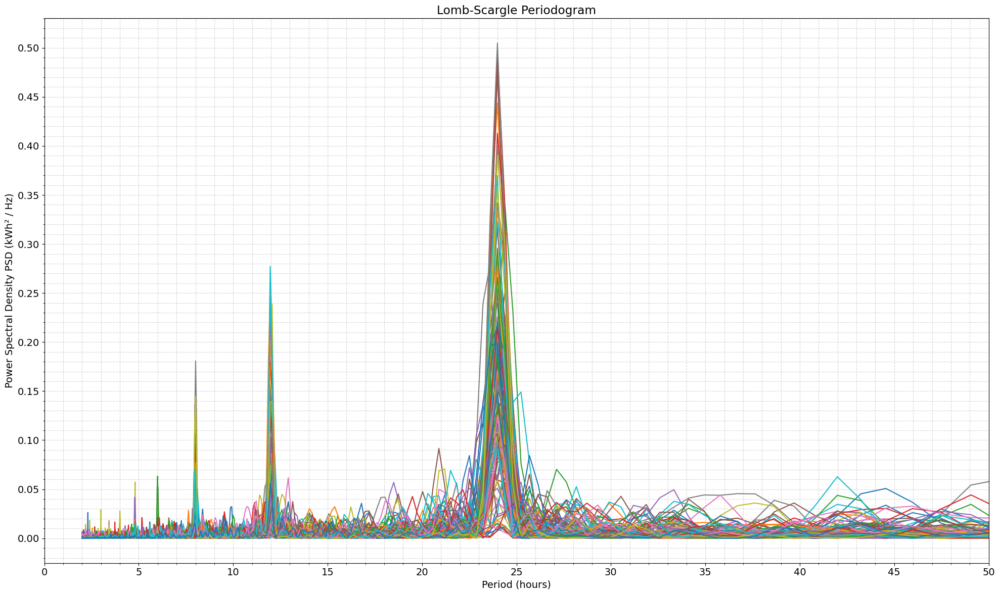

In [7]:
num_usuarios_a_mostrar = 111
usuarios_seleccionados = data.columns[:num_usuarios_a_mostrar]

# Convertimos el índice (fechas) a valores numéricos en horas
time = (data.index - data.index[0]).total_seconds() / 3600

plt.figure(figsize=(20, 12))
plt.rcParams.update({'font.size': 14})

frequencies = np.linspace(1/(1*168), 1/2, 720)  # Frecuencias en Hz
delta_f = frequencies[1] - frequencies[0]       # Resolución de frecuencia

for usuario in usuarios_seleccionados:
    
    consumo_usuario = data[usuario].dropna()
    tiempo_usuario = time[data[usuario].notna()]
    
    ls = LombScargle(tiempo_usuario, consumo_usuario)
    power_spectrum = ls.power(frequencies)
    periods = frequencies**-1

    plt.plot(periods, power_spectrum, label=f'{usuario}')

# Personalizar el gráfico
ax = plt.gca()
ax.xaxis.set_major_locator(MultipleLocator(5))
ax.xaxis.set_minor_locator(AutoMinorLocator(5))
ax.yaxis.set_major_locator(MultipleLocator(0.05))
ax.yaxis.set_minor_locator(AutoMinorLocator(5))
ax.grid(True, which='both', linestyle='--', alpha=0.5)

plt.xlim(0, 50)
plt.xlabel('Period (hours)')
plt.ylabel('Power Spectral Density PSD (kWh² / Hz)')
plt.title('Lomb-Scargle Periodogram')
plt.tight_layout()
#plt.legend(loc='upper right')
plt.show()

### Generación del perfil sintético
Con un criterio mayor a un 90% de representación de los datos, tomamos entonces estos 4 periodos a partir de estos picos PSD principales, como periodos de 4 señales que componen al perfil sintético representativo. Como el pico correspondiente a 6 horas posee una PSD menor al 0.1, la señal de 6 horas se considera la componente de ruído a ser eliminada.

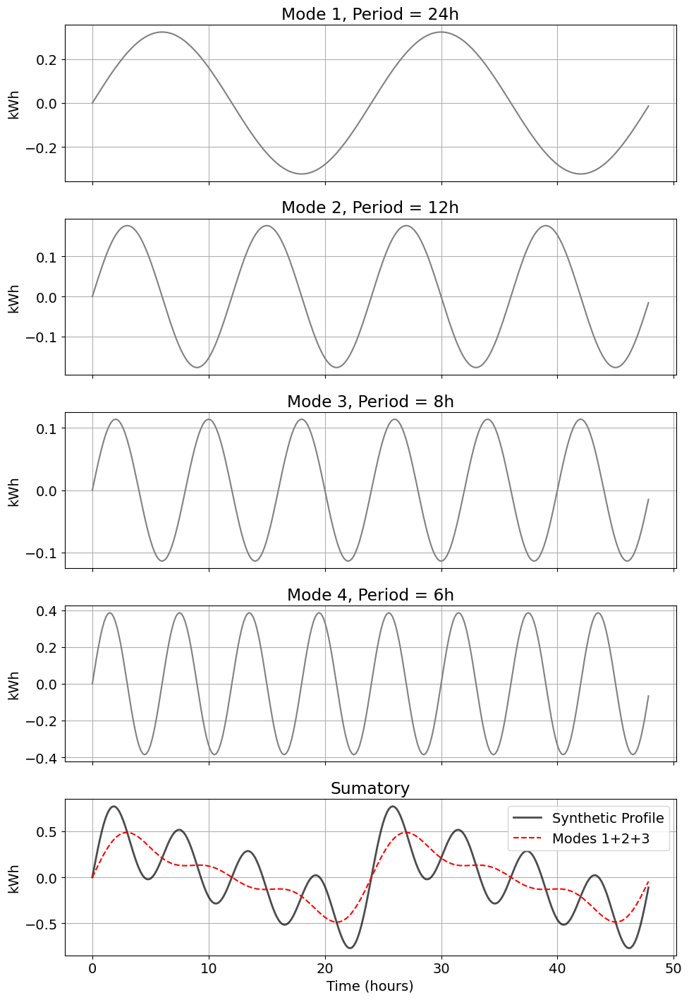

In [23]:
import numpy as np
import matplotlib.pyplot as plt

# Parámetros de tiempo
t_total_horas = 48
dt_min = 10  # resolución: cada 10 minutos
t = np.arange(0, t_total_horas, dt_min / 60)  # tiempo en horas

# Amplitudes originales
A1, A2, A3, A4 = 0.51, 0.28, 0.18, 0.61

# Calcular factor de escalamiento
total_amplitud = A1 + A2 + A3 + A4
factor = 1 / total_amplitud

# Escalar amplitudes
A1 *= factor
A2 *= factor
A3 *= factor
A4 *= factor

# Periodos en horas
P1, P2, P3, P4 = 24, 12, 8, 6

# Crear señales
s1 = A1 * np.sin(2 * np.pi * t / P1)
s2 = A2 * np.sin(2 * np.pi * t / P2)
s3 = A3 * np.sin(2 * np.pi * t / P3)
s4 = A4 * np.sin(2 * np.pi * t / P4)

# Sumas
suma_total = s1 + s2 + s3 + s4
suma_parcial = s1 + s2 + s3

# Crear figura con 5 subplots
fig, axs = plt.subplots(nrows=5, ncols=1, figsize=(10, 15), sharex=True)

# Subplot 1: Señal 1
axs[0].plot(t, s1, color='gray')
axs[0].set_title('Mode 1, Period = 24h')
axs[0].set_ylabel('kWh')
axs[0].grid(True)

# Subplot 2: Señal 2
axs[1].plot(t, s2, color='gray')
axs[1].set_title('Mode 2, Period = 12h')
axs[1].set_ylabel('kWh')
axs[1].grid(True)

# Subplot 3: Señal 3
axs[2].plot(t, s3, color='gray')
axs[2].set_title('Mode 3, Period = 8h')
axs[2].set_ylabel('kWh')
axs[2].grid(True)

# Subplot 4: Señal 4
axs[3].plot(t, s4, color='gray')
axs[3].set_title('Mode 4, Period = 6h')
axs[3].set_ylabel('kWh')
axs[3].grid(True)

# Subplot 5: Suma total
axs[4].plot(t, suma_total, label='Synthetic Profile', color='black', linewidth=2, alpha=0.7)
axs[4].plot(t, suma_parcial, label='Modes 1+2+3', color='red', linestyle='--')
axs[4].set_title('Sumatory')
axs[4].set_xlabel('Time (hours)')
axs[4].set_ylabel('kWh')
axs[4].grid(True)
axs[4].legend()

plt.tight_layout(rect=[0, 0, 1, 0.96])  # Deja espacio para el título superior
plt.show()


La misma idea es aplicada luego a todo el datased, el número de modos en el que será descompuesto usando VMD será K=4, y luego se recompondrá todas las señales sumando solo los 3 primeros modos, eliminando de esta manera la componente de ruido.

# Variational Mode Decomposition

In [5]:
from sktime.libs.vmdpy import VMD
from scipy.signal import find_peaks

In [6]:
# Diccionario para almacenar los resultados de la VMD de cada usuario
resultados_VMD = {}

# Seleccionar usuarios
usuarios_seleccionados = data.columns[0:121]

# Parámetros de VMD
alpha = 2000     # Penalización de ruido (ajustable)
tau = 0          # Parámetro de tolerancia (0 para VMD estricto)
DC = 0           # Sin sesgo DC
init = 1         # Inicialización aleatoria
tol = 1e-6       # Tolerancia de convergencia

# Iterar sobre diferentes valores de K
for K in range(1, 11):  # Desde K=1 hasta K=10
    resultados_VMD[K] = {}  # Diccionario para almacenar los resultados de este K
    
    for usuario in tqdm(usuarios_seleccionados):
        signal_usuario = data[usuario].dropna().values  
        signal_usuario = np.nan_to_num(signal_usuario)  

        # Aplicar VMD con el valor de K actual
        u, u_hat, omega = VMD(signal_usuario, alpha, tau, K, DC, init, tol)

        # Inicializar diccionario para almacenar los periodos estimados
        periodos_est = {}

        # Subplots 2 a K+1: Modos VMD
        for i in range(K):
            # Encontrar picos y estimar período
            peaks, _ = find_peaks(u[i, :])
            periodos = np.diff(peaks)
            periodo_estimado = np.mean(periodos) if len(periodos) > 0 else np.nan

            # Almacenar período estimado
            periodos_est[f"modo_{i+1}"] = periodo_estimado

        # Guardar resultados VMD incluyendo los periodos estimados
        resultados_VMD[K][usuario] = {
            "u": u, 
            "u_hat": u_hat, 
            "omega": omega, 
            "original": signal_usuario,
            "periodos_est": periodos_est  # Guardar períodos estimados
        }

# Verificar la estructura del diccionario
print(f"\nUsuarios almacenados en resultados_VMD: {list(resultados_VMD.keys())}")


100%|██████████| 121/121 [00:05<00:00, 22.06it/s]


Usuarios almacenados en resultados_VMD: [1, 2, 3, 4, 5, 6, 7, 8, 9, 10]


Para cada modo K del 1 al 10, se han descompuesto la curva de consumo de los 121 usuarios en esos modos indicados. Por ejemplo para K=2 se descomponen los 121 en 2 modos, para K=3 se descomponen los 121 en 3 modos, y así sucesivamente. Esta descomposición almacena en u, u_hat y omega tantos vectores de datos como modos K haya en cada iteración. Para K=2 por ejemplo, u = array([[vector_modo_1],[vector_modo_2]]), y así sucesivamente. Además para cada K y usuario se almacena el vector de datos originales, esto es, 552 valores de consumo en KWh.

In [7]:
resultados_VMD

{1: {'171': {'u': array([[1.66339212, 1.64447997, 1.61324821, 1.57123602, 1.52163622,
           1.46691461, 1.40925377, 1.35009645, 1.29173391, 1.23485453,
           1.18999561, 1.16101175, 1.14744071, 1.1497063 , 1.16747403,
           1.20120877, 1.25204487, 1.31886486, 1.38771025, 1.43793735,
           1.46536526, 1.49183249, 1.51221991, 1.52534926, 1.53099394,
           1.52475604, 1.50729476, 1.47999179, 1.44615315, 1.40665686,
           1.36292226, 1.31822023, 1.2736562 , 1.22911885, 1.19617189,
           1.17487286, 1.16474153, 1.16738484, 1.17939305, 1.19860049,
           1.2108864 , 1.21809845, 1.23003251, 1.25124991, 1.28257772,
           1.31116632, 1.3260438 , 1.31726294, 1.28463236, 1.24292387,
           1.19588981, 1.1473795 , 1.09864784, 1.05248573, 1.00933202,
           0.97202187, 0.941684  , 0.91914036, 0.90633715, 0.90539754,
           0.91645818, 0.93971277, 0.97563326, 1.02451761, 1.08405258,
           1.15329208, 1.23396327, 1.32415845, 1.40736768, 1.4

### Periodos estimados en promedio

In [8]:
# Diccionario para almacenar el período estimado promedio por K y modo
periodo_estimado_promedio = {}

# Iterar sobre los valores de K en resultados_VMD
for K, usuarios_data in resultados_VMD.items():
    periodo_estimado_promedio[K] = {}  # Inicializar diccionario para este K

    # Obtener la cantidad de modos disponibles para este K y ordenarlos correctamente
    modos_disponibles = set()
    for usuario, datos in usuarios_data.items():
        modos_disponibles.update(datos["periodos_est"].keys())

    # Ordenar los modos en base a su número (modo_1, modo_2, ..., modo_n)
    modos_ordenados = sorted(modos_disponibles, key=lambda m: int(m.split("_")[1]))

    # Calcular el promedio de cada modo
    for modo in modos_ordenados:
        valores_periodo = [
            datos["periodos_est"][modo] 
            for usuario, datos in usuarios_data.items() 
            if modo in datos["periodos_est"] and not np.isnan(datos["periodos_est"][modo])
        ]

        # Almacenar el promedio si hay valores disponibles
        periodo_estimado_promedio[K][modo] = np.mean(valores_periodo) if valores_periodo else np.nan


In [9]:
periodo_estimado_promedio
# Promediado de los periodos estimados de todos los usuarios en un arreglo triangular

{1: {'modo_1': 18.791024360673244},
 2: {'modo_1': 18.169102830477712, 'modo_2': 11.971898522256373},
 3: {'modo_1': 18.401665016273437,
  'modo_2': 15.031370311097524,
  'modo_3': 5.178199064155201},
 4: {'modo_1': 19.506791613778365,
  'modo_2': 16.194131734102044,
  'modo_3': 6.863606390796258,
  'modo_4': 3.350935186000608},
 5: {'modo_1': 19.91803009334817,
  'modo_2': 17.792050012128524,
  'modo_3': 8.129517088566718,
  'modo_4': 4.631683136036615,
  'modo_5': 2.869736843917401},
 6: {'modo_1': 21.302805990838593,
  'modo_2': 18.753095218812653,
  'modo_3': 8.954319319799698,
  'modo_4': 5.32550676114094,
  'modo_5': 3.5427125199657636,
  'modo_6': 2.5096772720554545},
 7: {'modo_1': 23.185494902385713,
  'modo_2': 19.27395828245545,
  'modo_3': 9.494250557222072,
  'modo_4': 5.9846767072406655,
  'modo_5': 4.159065040638692,
  'modo_6': 3.048102306404843,
  'modo_7': 2.346087019785467},
 8: {'modo_1': 24.38830610722572,
  'modo_2': 20.3957480181801,
  'modo_3': 9.934497627978761

# Determinación de la mejor K

In [13]:
from sklearn.metrics import mean_squared_error

# Curva ideal
modos_ideal = [1, 2, 3, 4]
periodos_ideal = [24, 12, 8, 6] # obtenidos del LSP

# Diccionario para almacenar el RMSE de cada K
mse_periodos_estimados = {}

# Iterar sobre cada K en periodo_estimado_promedio
for K, modos_data in periodo_estimado_promedio.items():
    # Extraer los modos disponibles en este K y ordenarlos correctamente
    modos_disponibles = sorted(modos_data.keys(), key=lambda m: int(m.split("_")[1]))
    
    # Obtener solo los modos que coinciden con la curva ideal
    modos_filtrados = [m for m in modos_disponibles if int(m.split("_")[1]) in modos_ideal]
    
    # Si no hay modos coincidentes, asignar NaN y continuar
    if not modos_filtrados:
        mse_periodos_estimados[K] = np.nan
        continue
    
    # Obtener los periodos estimados correspondientes a los modos filtrados
    periodos_reales = [modos_data[m] for m in modos_filtrados]
    
    # Obtener los periodos ideales correspondientes
    periodos_ideal_filtrados = [periodos_ideal[modos_ideal.index(int(m.split("_")[1]))] for m in modos_filtrados]

    # Calcular RMSE asegurando que ambas listas tengan el mismo tamaño
    mse_periodos_estimados[K] = mean_squared_error(periodos_ideal_filtrados, periodos_reales, squared=False)


mse_periodos_estimados

{1: 5.208975639326756,
 2: 4.123114811316464,
 3: 4.020494209860059,
 4: 3.3944291651477645,
 5: 3.6089952680159665,
 6: 3.6825540407038173,
 7: 3.735201038096924,
 8: 4.319670100111094,
 9: 5.179717572043837,
 10: 6.325348217411645}

Se concluye que el mejor valor de K para descomponer con el VMD con el mínimo MSE es 4

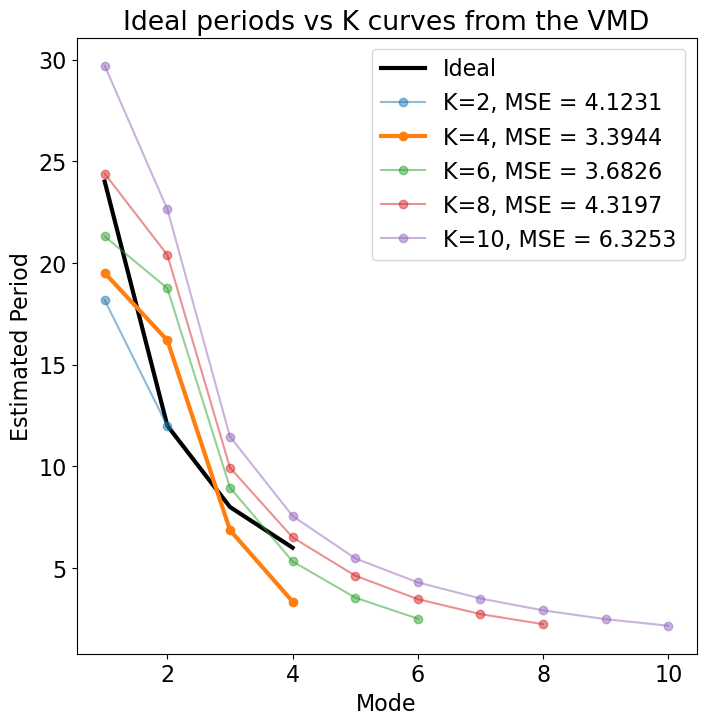

In [14]:
# Definir los modos ideales y sus períodos
modos_ideal = [1, 2, 3, 4]
periodos_ideal = [24, 12, 8, 6]

# Crear la figura
plt.figure(figsize=(8, 8))
plt.rcParams.update({'font.size': 16})

# Graficar la curva ideal en negro con un grosor mayor
plt.plot(modos_ideal, periodos_ideal, 'k-', linewidth=3, label="Ideal")

# Graficar las curvas obtenidas para cada K de 1 a 10
for K in range(2, 11, 2):
    if K in periodo_estimado_promedio:
        # Obtener los modos disponibles para este K
        modos_disponibles = sorted(periodo_estimado_promedio[K].keys(), key=lambda m: int(m.split("_")[1]))
        
        # Extraer los periodos estimados
        periodos_reales = [periodo_estimado_promedio[K][m] for m in modos_disponibles]
        modos_numericos = [int(m.split("_")[1]) for m in modos_disponibles]

        # Graficar la curva de cada K
        if (K==4):
            plt.plot(modos_numericos, periodos_reales, linewidth=3, marker='o', linestyle='-', label=f"K={K}, MSE = {mse_periodos_estimados[K]:.4f}",alpha=1)
        else:
            plt.plot(modos_numericos, periodos_reales, marker='o', linestyle='-', label=f"K={K}, MSE = {mse_periodos_estimados[K]:.4f}",alpha=0.5)

# Etiquetas y leyenda
plt.xlabel("Mode")
plt.ylabel("Estimated Period")
plt.title("Ideal periods vs K curves from the VMD")
plt.legend()
#plt.grid(True)
plt.show()


Procesando K=1
✔ Agregado: K=1, modo=1, periodo=18.791024360673244

Procesando K=2
✔ Agregado: K=2, modo=1, periodo=18.169102830477712
✔ Agregado: K=2, modo=2, periodo=11.971898522256373

Procesando K=3
✔ Agregado: K=3, modo=1, periodo=18.401665016273437
✔ Agregado: K=3, modo=2, periodo=15.031370311097524
✔ Agregado: K=3, modo=3, periodo=5.178199064155201

Procesando K=4
✔ Agregado: K=4, modo=1, periodo=19.506791613778365
✔ Agregado: K=4, modo=2, periodo=16.194131734102044
✔ Agregado: K=4, modo=3, periodo=6.863606390796258
✔ Agregado: K=4, modo=4, periodo=3.350935186000608

Procesando K=5
✔ Agregado: K=5, modo=1, periodo=19.91803009334817
✔ Agregado: K=5, modo=2, periodo=17.792050012128524
✔ Agregado: K=5, modo=3, periodo=8.129517088566718
✔ Agregado: K=5, modo=4, periodo=4.631683136036615
✔ Agregado: K=5, modo=5, periodo=2.869736843917401

Procesando K=6
✔ Agregado: K=6, modo=1, periodo=21.302805990838593
✔ Agregado: K=6, modo=2, periodo=18.753095218812653
✔ Agregado: K=6, modo=3, pe

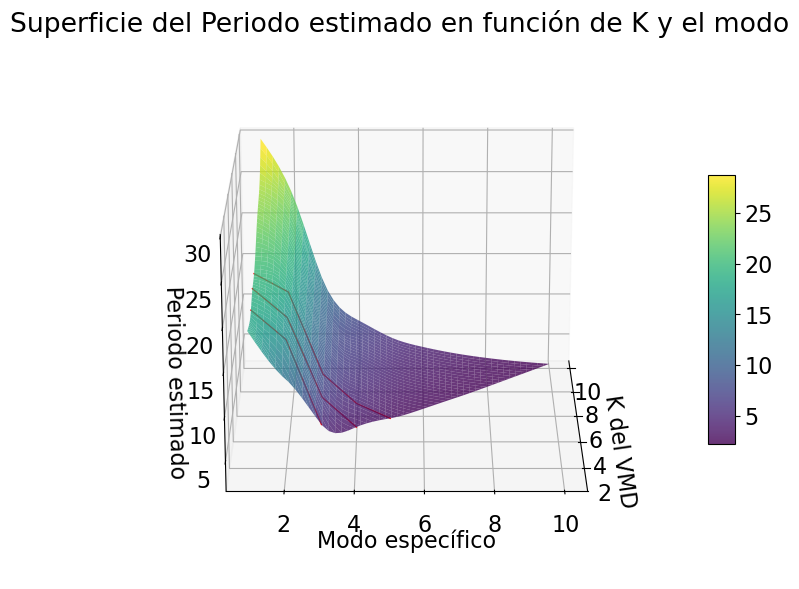

In [15]:
import numpy as np
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
from scipy.interpolate import griddata

X, Y, Z = [], [], []

for K, modos_dict in periodo_estimado_promedio.items():
    print(f"\nProcesando K={K}")
    try:
        K_num = int(K)  # Convertir K a número
    except ValueError:
        print(f"❌ K inválido: {K}")
        continue

    for modo, periodo in modos_dict.items():
        try:
            modo_num = int(modo.replace("modo_", ""))  # Eliminar "modo_"
        except ValueError:
            print(f"❌ Modo inválido: {modo}")
            continue
        
        if np.isnan(periodo):
            print(f"❌ NaN en K={K}, modo={modo}")
            continue

        print(f"✔ Agregado: K={K_num}, modo={modo_num}, periodo={periodo}")
        X.append(K_num)
        Y.append(modo_num)
        Z.append(periodo)

# Convertir listas a arrays de numpy
X = np.array(X)
Y = np.array(Y)
Z = np.array(Z)

# Crear una malla de valores de K y modos
xi = np.linspace(min(X), max(X), 50)  # Interpolación en K
yi = np.linspace(min(Y), max(Y), 50)  # Interpolación en Modos
Xi, Yi = np.meshgrid(xi, yi)

# Interpolar valores de Z para la superficie
Zi = griddata((X, Y), Z, (Xi, Yi), method='cubic')

# Crear la figura y el eje 3D
fig = plt.figure(figsize=(10, 7))
ax = fig.add_subplot(111, projection='3d')

# Crear la superficie
surf = ax.plot_surface(Xi, Yi, Zi, cmap='viridis', edgecolor='none', alpha=0.8)

# Agregar barra de colores
fig.colorbar(surf, ax=ax, shrink=0.5, aspect=10)

# Etiquetas de los ejes
ax.set_xlabel('K del VMD')
ax.set_ylabel('Modo específico')  ##############################################
ax.set_zlabel('Periodo estimado') ### Utilizar una métrica de error como eje ###
                                  ##############################################
# Invertir el eje Y
ax.invert_yaxis()

# Rotar la vista para mejor perspectiva
ax.view_init(elev=20, azim=180)  #####        Cambia los ángulos según lo necesites      ####

# Título
ax.set_title('Superficie del Periodo estimado en función de K y el modo')

# ---- AGREGAR CURVAS ROJAS PARA K=3, K=4, K=5 ----
for k_value in [3, 4, 5]:
    mask = X == k_value  # Filtrar datos donde K = k_value
    ax.plot(
        [k_value] * len(Y[mask]),  # K constante
        Y[mask],  # Modos específicos
        Z[mask],  # Periodo estimado
        'r-', linewidth=1
    )

# Mostrar la gráfica
plt.show()